# 2.2. Построение простого стационарного решения уравнения фильтрации и отображение с использованием библиоткеи plotly

Материалы курсов "Исследования скважин и пластов" и "Гидродинамические исследования скважин" в РГУ нефти и газа имени И.М.Губкина.

Версия 0.1 от 04.10.2023

Хабибуллин Ринат 2023 г.


$$
P_{r} = P_{res} - 18.41\dfrac{ Q\mu B }{kh} \left[ \ln\dfrac{r_e}{r} +S \right]
\tag{1}
$$

In [1]:
# импортируем библиотеки для расчетов

# numpy используем для работы с массивами и подготовки данных для построения графиков. 
# Также в некоторых функциях используем возможности векторных расчетов numpy
import numpy as np


# plotly используем как альтернативный инструмент построения графиков
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
def p_ss_atma(p_res_atma = 250,
              q_liq_sm3day = 50,
              mu_cP = 1,
              B_m3m3 = 1.2,
              k_mD = 40,
              h_m = 10,
              r_e_m = 240,
              r_m = 0.1):
  """
  функция расчета давления в произвольной точке пласта для стационарного решения 
  уравнения фильтрации 
  p_res_atma - пластовое давление, давление на контуре питания
  q_liq_sm3day - дебит жидкости на поверхности в стандартных условиях
  mu_cP - вязкость нефти (в пластовых условиях)
  B_m3m3 - объемный коэффициент нефти 
  k_mD - проницаемость пласта
  h_m - мощность пласта
  r_e_m - радиус контрура питания 
  r_m - расстояние на котором проводится расчет
  """
  return p_res_atma - 18.41 * q_liq_sm3day*mu_cP*B_m3m3/k_mD/h_m * np.log(r_e_m/r_m)

Для построения графиков можно использовать библиотеку `plotly`. Эта библиотека позволяет строить широкий набор графиков. Приведем примеры построения трехмерных поверхностей распределения давления для ранее построенных массивов. Графики получаются интерактивные и их отображение может быть гибко настроено пользователем.

Построение воронки депрессии с использованием базовой тепловой карты. Еще одна из отличительных особенностей библиотеки **Plotly** - это то, что при наведении курсора на график можно сразу посмотреть значения в интерсующей точке на нем (какое значение давления соотвествует координатам x,y):

Построим карту пластовых давлений с использованием формулы Дюпюи. 

Для построения карты необходимо рассчитать значения давления на регулярной сетке, что можно сделать с использованием функции `np.meshgrid`

Для построения карты полезно вспомнить, что расстояние от скважины с координатами $(x_{well}, y_{well})$ до произвольной точки пласта с координатами $(x,y)$ можно найти по формуле 
$$
r=\sqrt{ (x-x_{well})^2 + (y-y_{well})^2 }
\tag{2}
$$

In [3]:
# зададим параметры воронки депрессии
pres = 250 
r_e = 300

# зададим координатную сетку основываясь на параметрах
x = np.linspace(-r_e, r_e, 300)
y = np.linspace(-r_e, r_e, 300)
# рассчитаем вспомогательные вектора для построения сетки
xv, yv = np.meshgrid(x, y)
# зададим координаты скважины
xwell1 = 0
ywell1 = 0
# рассчитаем значение давлений во всех точках сетки
p_mesh = p_ss_atma(r_m=((xv-xwell1)**2 + (yv-ywell1)**2)**0.5, p_res_atma=pres, r_e_m=r_e)
# удалим значения за контуром, так как в данном случае они не имеют смысла
p_mesh[np.where(p_mesh > pres)] = pres

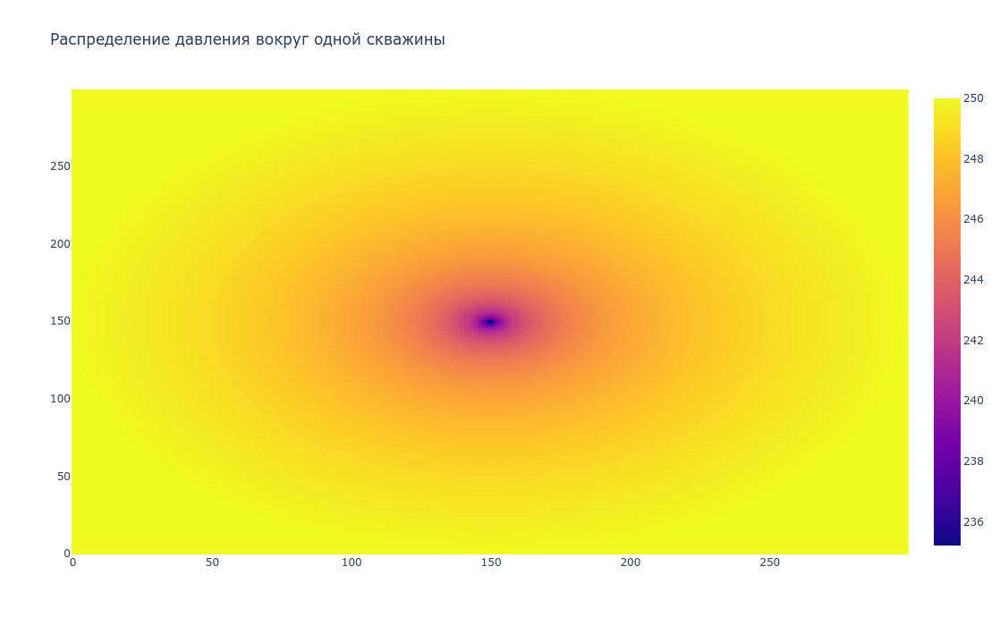

In [4]:
fig = go.Figure(data=go.Heatmap(
                    z = p_mesh))
fig.update_layout(
    title='Распределение давления вокруг одной скважины',
    width = 700, height = 700, 
    autosize = False)

fig.show()

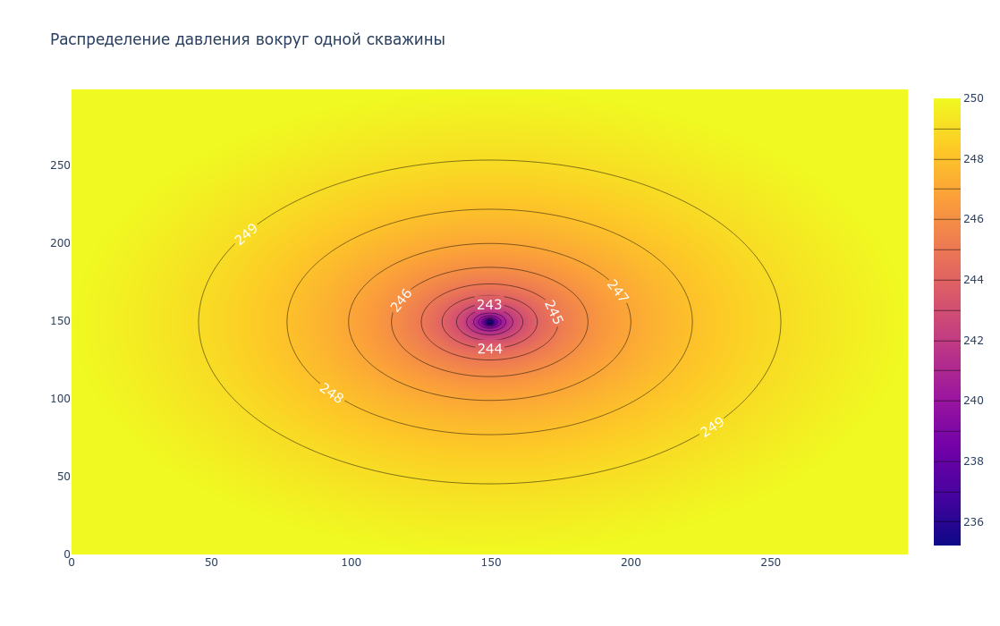

In [5]:
fig = go.Figure(data=
    go.Contour(
        z = p_mesh,
        contours = dict(
            coloring ='heatmap',
            showlabels = True, # показывать значения на изолиниях или нет
            labelfont = dict( # Параметры шрифта подписей 
                size = 15,
                color = 'white',
            )
        )))
fig.update_layout(
    title='Распределение давления вокруг одной скважины',
    width = 700, height = 700, 
    autosize = False)
fig.show()

Построение **воронки депрессии** в 3D:

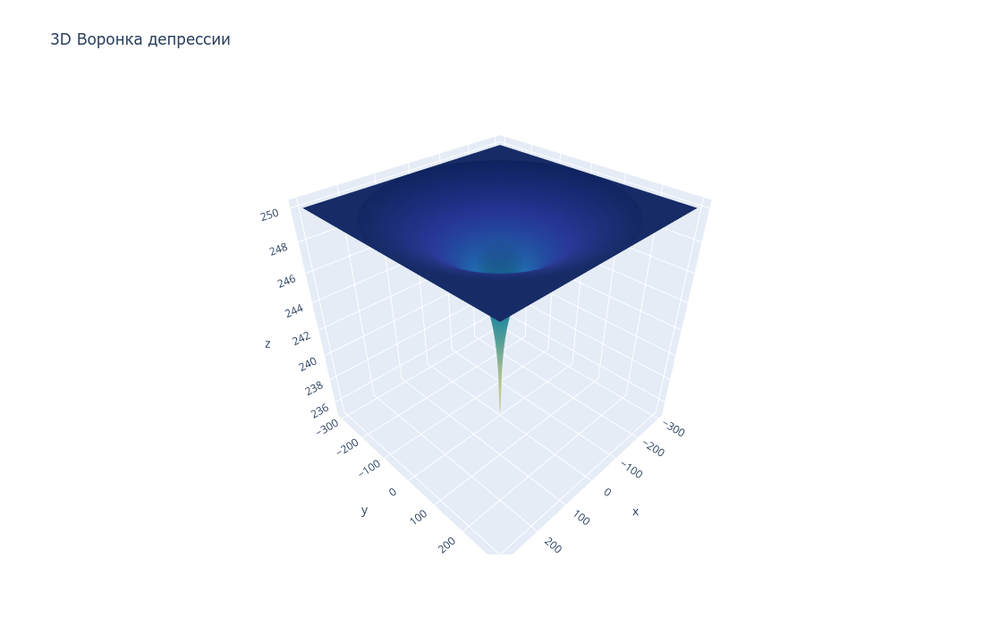

In [6]:
fig = make_subplots(
    rows=1, cols=1,
    specs=[[{'type': 'surface'}]]
)

fig.add_trace(
    go.Surface(x=x, y=y, z=p_mesh, colorscale='YlGnBu', showscale=False),
    row=1, col=1)
fig.update_layout(
    title_text='3D Воронка депрессии',
    height=700,
    width=700
)

fig.show()

Суперпозиция для стационарного решения

Перепад давления в произвольной точке пласта с координатами $(x,y)$ можно оценить как
$$
P_{res} - P_{x,y} = \sum_{i} 18.41\dfrac{ Q_i\mu B }{kh} \left[ \ln\dfrac{r_e}{\sqrt{ (x-x_{i})^2 + (y-y_{i})^2 }} +S \right]  
\tag{3}
$$

В этом выражении пласт предполагается однородным изотроптым с постоянными свойствами.

In [7]:
# зададим параметры воронки депрессии
pres = 250 
r_e = 300

# зададим координатную сетку основываясь на параметрах
x = np.linspace(-r_e, r_e, 300)
y = np.linspace(-r_e, r_e, 300)
# рассчитаем вспомогательные вектора для построения сетки
xv, yv = np.meshgrid(x, y)

# зададим координаты скважины (всего будет 5 скважин у которых меняется только х координата)
xwell = [-100, -50, 0 , 50, 100]
ywell = 0

# зададим пустой список сеток с перепадами давлений от каждой отдельной скважины
p_mesh_i=[]

# для каждой скважины найдем ее влияние на давления
for xi in xwell:
    # рассчитаем значение давлений во всех точках сетки для скважины i
    p_mesh_i_ = p_ss_atma(r_m=((xv-xi)**2 + (yv-ywell)**2)**0.5, p_res_atma=pres, r_e_m=r_e)
    # удалим значения за контуром, так как в данном случае они не имеют смысла
    p_mesh_i_[np.where(p_mesh_i_ > pres)] = pres
    p_mesh_i.append(p_mesh_i_)
    
# найдем суммарное влияние все скважин
p_mesh_sum = 0
for p_mesh_i_ in p_mesh_i:
    # найдем сумму решений, помним что суммировать можно депрессии
    p_mesh_sum = pres - p_mesh_i_ + p_mesh_sum
p_mesh_sum = pres -  p_mesh_sum

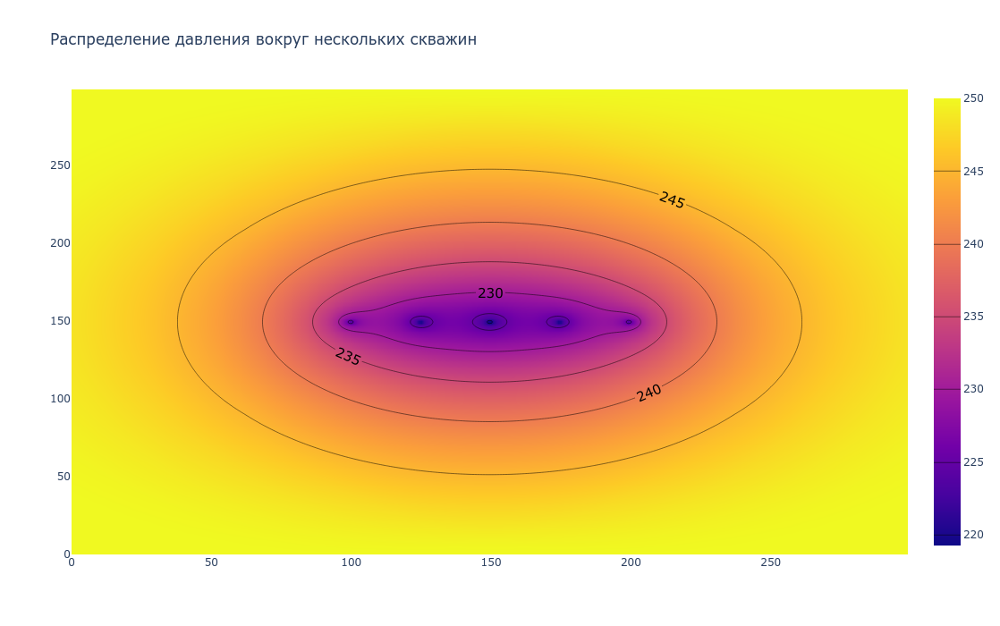

In [8]:
fig = go.Figure(data=
    go.Contour(
        z = p_mesh_sum,
        contours = dict(
            coloring ='heatmap',
            showlabels = True, # показать значения на изолиниях
            labelfont = dict( # Параметры шрифта подписей 
                size = 15,
                color = 'black',
            )
        )))
fig.update_layout(
    title='Распределение давления вокруг нескольких скважин',
    width = 700, height = 700, 
    autosize = False)
fig.show()

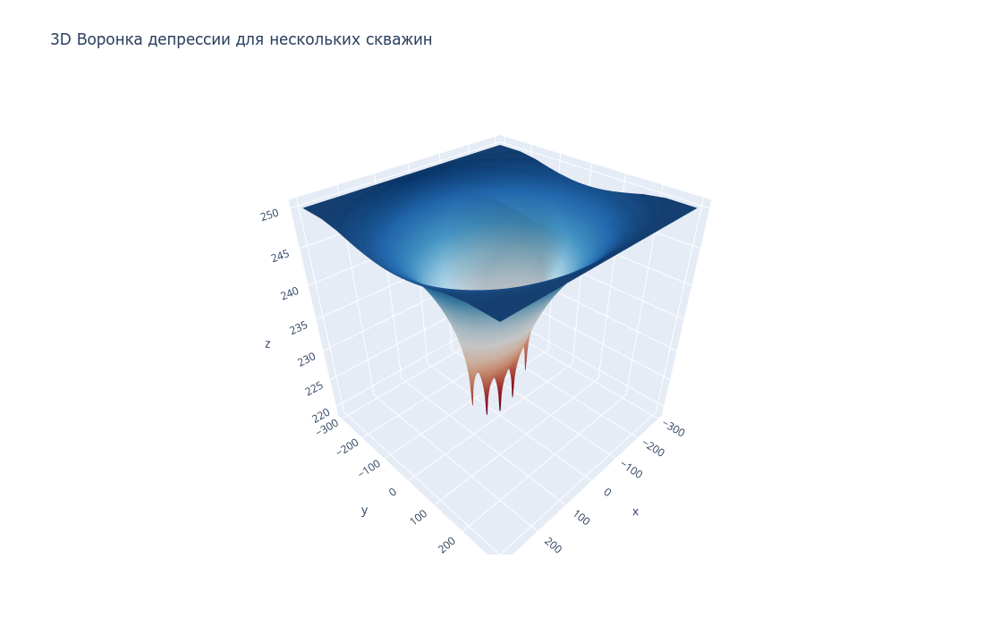

In [9]:
fig = make_subplots(
    rows=1, cols=1,
    specs=[[{'type': 'surface'}]]
)

fig.add_trace(
    go.Surface(x=x, y=y, z=p_mesh_sum, colorscale='RdBu', showscale=False),
    row=1, col=1)
fig.update_layout(
    title_text='3D Воронка депрессии для нескольких скважин',
    height=700,
    width=700
)

fig.show()


Выражение (3) позволяет рассчитать распределение давления в пласте с рядом скважин дебиты которых известны. В том числе могут быть найдены и забойные давления скважин. На практике часто интерес представляет задача определения дебитов скважин по известному забойному давлению. 

Для решения этой задачи можно записать систему уравнений на забойные давления скважин

$$
P_{res} - P_{wf\_i} = \sum_{i} 18.41\dfrac{ Q_i\mu B }{kh} \left[ \ln\dfrac{r_e}{\sqrt{ (x-x_{i})^2 + (y-y_{i})^2 }} +S \right]  
\tag{4}
$$

можно заметить, что при постоянных параметрах пласта и флюида это система линейных уравнений, где неизвестными являются $Q_i$. Решив эту систему уравнений можно получить дебиты скважин при известном забойном давлении.
